In [2]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation

Punto 1 

11115


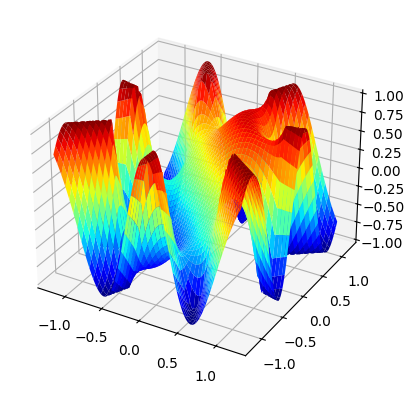

In [3]:
Nx=200
Ny=200
x=np.linspace(-1.2,1.2,Nx)
y=np.linspace(-1.2,1.2,Ny)
s=x[1]-x[0]



X, Y = np.meshgrid(x, y)

phi = np.zeros( (Nx,Ny) ) 


rho=-X-Y
R=X**2 + Y**2
theta = np.arctan2(Y, X)
phi[R >= 1] = np.sin(7 * theta[R >= 1])

d=1
iteraciones =0
while d > 10**(-4):
    phi_nueva = phi.copy()
    d=0
    for i in range(0,Nx):
        for j in range(0,Ny):
            if R[i,j]<1:
                phi_nueva[i,j]=(phi[i-1,j] + phi[i+1,j] + phi[i,j-1] + phi[i,j+1])/4 -  np.pi * rho[i,j] * s**2
    d = np.trace(np.abs(phi_nueva - phi))
    phi = phi_nueva.copy() 
    iteraciones+=1
print (iteraciones)

fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
surf  = ax.plot_surface(X, Y, phi_nueva, cmap='jet')
plt.show()


Nota: Convergio a los 4 minutos con 11115 iteraciones

In [4]:
ax.view_init(elev=30, azim=80)

def draw_frame(frame):
    ax.view_init(elev=30, azim=frame)  
    return surf

anim = FuncAnimation(fig, draw_frame, frames=np.arange(0, 360, 1))

anim.save("heat.mp4")

anim


Animation size has reached 21035908 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


Punto 2

In [ ]:
L=2
C=1
Nt=1000
Nx=100

U=np.zeros((Nt,Nx))
U1=np.zeros((Nt,Nx))
U2=np.zeros((Nt,Nx))


x=np.linspace(0,L,Nx)



ht = 0.0101
hx = L/(Nx-1)


c=(C/hx)*ht


c=0.9
print(c)

U[0,:]=np.exp(-125*((x-1/2)**2))

for i in range(1,Nt-1):
  for j in range(1,Nx-1):
    U[i+1,j] = 2*U[i,j] + -U[i-1,j]  + c**2*(U[i,j+1] -2*U[i,j] + U[i,j-1])
    U[i,0]=0
    U[i,-1]=0


U1[0,:]=np.exp(-125*((x-1/2)**2))

for i in range(1,Nt-1):
  for j in range(1,Nx-1):
    U1[i+1,j] = 2*U1[i,j] -U1[i-1,j]  + c**2*(U1[i,j+1] -2*U1[i,j] + U1[i,j-1])
  
    U1[i+1, 0] = 2 * U1[i, 0] - U1[i-1, 0] + c**2 * (U1[i, 1] - 2 * U1[i, 0] + U1[i, 1]) 
    U1[i+1, -1] = 2 * U1[i, -1] - U1[i-1, -1] + c**2 * (U1[i, -2] - 2 * U1[i, -1] + U1[i, -2]) 


U2[0,:]=np.exp(-125*((x-1/2)**2))


for i in range(1,Nt-1):
  for j in range(1,Nx-1):
    U2[i+1,j] = 2*U2[i,j] - U2[i-1,j]  + c**2*(U2[i,j+1] -2*U2[i,j] + U2[i,j-1])
    U2[i+1, 0] = 2 * U2[i, 0] - U2[i-1, 0] + c**2 * (U2[i, 1] - 2 * U2[i, 0] + U2[i, -1]) 
    U2[i+1, -1] = 2 * U2[i, -1] - U2[i-1, -1] + c**2 * (U2[i, 0] - 2 * U2[i, -1] + U2[i, -2])

In [ ]:
fig, axs = plt.subplots(2, 2)
fig.suptitle('Funciones de Onda')

line_u, = axs[0, 0].plot([], [], lw=3, color="red")
line_u1, = axs[0, 1].plot([], [], lw=3, color="green")
line_u2, = axs[1, 0].plot([], [], lw=3, color="blue")

for ax in axs.flat:
    ax.set_xlim(0,L)
    ax.set_ylim(-100, 100)

axs[0, 0].set_title('U(x, t)')
axs[0, 1].set_title('U1(x, t)')
axs[1, 0].set_title('U2(x, t)')
axs[1, 1].axis('off') 


def init():
    line_u.set_data([], [])
    line_u1.set_data([], [])
    line_u2.set_data([], [])
    return line_u, line_u1, line_u2

def update(i):
    y_u = U[i,:]
    y_u1 = U1[i,:]
    y_u2 = U2[i,:]
    
    line_u.set_data(x, y_u)
    line_u1.set_data(x, y_u1)
    line_u2.set_data(x, y_u2)
    return line_u, line_u1, line_u2


anim = FuncAnimation(fig, update, frames=Nt, init_func=init, blit=True, interval=50)

anim.save('video_punto_2.mp4')
plt.show()

Punto 3

In [ ]:
Nx=100
L=1.999
alpha=0.022


x=np.linspace(0,L,Nx)
h = (x[1]-x[0])
t=np.arange(0,0.3,0.00001)
Nt=len(t)
k = (t[1]-t[0])
print(k,h)



psi=np.zeros((Nt,Nx))

psi[0,:]=np.cos(np.pi*x)
psi[1,:]=np.cos(np.pi*x)


A=(k/h)*(1/3)
B=(alpha**2)*(k/(h**3))
print(A,B)


for i in range(1,Nt-1):
  for j in range(0,Nx):
    psi[i+1,j]=psi[i-1,j]-A*(psi[i,(j+1)%Nx]+psi[i,j]+psi[i,(j-1)%Nx])*(psi[i,(j+1)%Nx]-psi[i,(j-1)%Nx])-B*(psi[i,(j+1)%Nx]-2*psi[i,(j+1)%Nx]+2*psi[i,(j-1)%Nx]-psi[i,(j-2)%Nx])
    
masa = np.zeros(Nt)
momento = np.zeros(Nt)
energia = np.zeros(Nt)

for i in range (0,Nt-1):
    for j in range (0,Nx):
      masa[i]=psi[i,j]
      momento[i]=(psi[i,j])**2
    
for i in range (0,Nt):
    for j in range (1,Nx-1):
      energia[i]=(1/3)*(psi[i,j])**3-(alpha*(psi[i,j+1]-psi[i,j-1])/h)**2

sum1=np.mean(masa)
sum2=np.mean(momento)
sum3=np.mean(energia)

      

fig=plt.figure()
ax = plt.gca()
fig.suptitle('Funcion')

line, = ax.plot([], [], lw=3, color="red")


ax.set_xlim(0,L)
ax.set_ylim(-5, 5)
ax.set_title('psi(t, x)')



def init():
    line.set_data([], [])
    return line,

def update(i):
    y_u = psi[::50][i,:]
    line.set_data(x, y_u)
    return line,


anim = FuncAnimation(fig, update, frames=Nt//50, init_func=init, blit=True, interval=50)

anim.save('video_punto_32.mp4')
plt.show()

Psifourier=np.fft.fft(psi)

Punto 4